In [68]:
import geopandas as gpd
import geoplot

In [3]:
# Utility - Convert *.shp file to .geojson file with GeoPandas

# Load shp data file
region = gpd.read_file('cafaults_dd.shp')
# Convert resolution to match the base of gravity data we use as sample
# region['geometry'] = region['geometry'].to_crs(epsg=4326)
# # Save as .geojson file using GeoJSON engine to convert
# region.to_file("cafault.geojson", driver="GeoJSON")

In [4]:
region

,FNODE_,TNODE_,LPOLY_,RPOLY_,LENGTH,CAFAULTS_D,CAFAULTS_1,ARC_CODE,ARC_PARA1,ARC_PARA2,SOURCE,geometry
0,4,7,10984,10984,0.052213,1,42197,31,0,0,CA001,"LINESTRING (-125.17129 41.99627, -125.17051 41..."
1,3,9,10984,10984,0.100419,2,42225,31,0,0,CA001,"LINESTRING (-125.27394 41.99562, -125.27224 41..."
2,8,10,10984,10984,0.025657,3,42168,31,0,0,CA001,"LINESTRING (-124.87544 41.99766, -124.87299 41..."
3,15,16,10984,10984,0.046745,4,42198,31,0,0,CA001,"LINESTRING (-125.08587 41.90180, -125.08335 41..."
4,11,17,10984,10984,0.065551,5,42199,31,0,0,CA001,"LINESTRING (-125.13638 41.90663, -125.12909 41..."
...,...,...,...,...,...,...,...,...,...,...,...,...
28738,47093,47389,4486,4486,0.203779,28739,58060,32,0,0,CA001,"LINESTRING (-115.71243 32.77189, -115.69666 32..."
28739,47306,47390,4486,4486,0.077704,28740,58045,32,0,0,CA001,"LINESTRING (-115.22192 32.77273, -115.20497 32..."
28740,47391,46831,4486,4486,0.295506,28741,50750,87,0,0,CA001,"LINESTRING (-115.35643 32.67477, -115.35881 32..."
28741,47318,47392,10691,10691,0.137075,28742,58046,32,0,0,CA001,"LINESTRING (-114.91583 32.81173, -114.86296 32..."


In [8]:
region['geometry'].crs

<Geographic 2D CRS: EPSG:4267>
Name: NAD27
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - NAD27
- bounds: (167.65, 7.15, -47.74, 83.17)
Datum: North American Datum 1927
- Ellipsoid: Clarke 1866
- Prime Meridian: Greenwich

<AxesSubplot:>

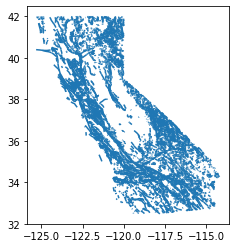

In [5]:
region.plot()

In [73]:
region.geometry.convex_hull

0        POLYGON ((-125.17144 41.94418, -125.17129 41.9...
1        POLYGON ((-125.22436 41.90854, -125.22781 41.9...
2        LINESTRING (-124.87544 41.99766, -124.87299 41...
3        POLYGON ((-125.08309 41.85521, -125.08587 41.9...
4        POLYGON ((-125.12949 41.84158, -125.13638 41.9...
                               ...                        
28738    POLYGON ((-115.54155 32.66134, -115.60879 32.7...
28739    POLYGON ((-115.17679 32.71016, -115.20497 32.7...
28740    POLYGON ((-115.35643 32.67477, -115.46926 32.7...
28741    POLYGON ((-114.80180 32.73571, -114.80699 32.7...
28742    POLYGON ((-114.76884 32.71533, -114.80180 32.7...
Length: 28743, dtype: geometry

In [6]:
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import griddata
from matplotlib import cm

import datashader as ds
import plotly.express as px
import plotly.graph_objects as go

from PIL import Image, ImageOps

import pickle

In [8]:
sf = pd.DataFrame()
sf['latitude'] = [37.7739]
sf['longitude'] = [-122.4312]

In [61]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

fig = px.choropleth_mapbox(
                           list(region.columns),
                           geojson=region.geometry.convex_hull,
                           color=['ARC_CODE'],
                           color_continuous_scale="jet",
                           range_color=(0, 129),
                           mapbox_style="carto-positron",
                           zoom=3, 
                           center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [60]:
list(region.columns)

['FNODE_',
 'TNODE_',
 'LPOLY_',
 'RPOLY_',
 'LENGTH',
 'CAFAULTS_D',
 'CAFAULTS_1',
 'ARC_CODE',
 'ARC_PARA1',
 'ARC_PARA2',
 'SOURCE',
 'geometry']

In [49]:
type(region['geometry'])

geopandas.geoseries.GeoSeries

In [50]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

In [51]:
counties

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'GEO_ID': '0500000US01001',
    'STATE': '01',
    'COUNTY': '001',
    'NAME': 'Autauga',
    'LSAD': 'County',
    'CENSUSAREA': 594.436},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-86.496774, 32.344437],
      [-86.717897, 32.402814],
      [-86.814912, 32.340803],
      [-86.890581, 32.502974],
      [-86.917595, 32.664169],
      [-86.71339, 32.661732],
      [-86.714219, 32.705694],
      [-86.413116, 32.707386],
      [-86.411172, 32.409937],
      [-86.496774, 32.344437]]]},
   'id': '01001'},
  {'type': 'Feature',
   'properties': {'GEO_ID': '0500000US01009',
    'STATE': '01',
    'COUNTY': '009',
    'NAME': 'Blount',
    'LSAD': 'County',
    'CENSUSAREA': 644.776},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-86.577799, 33.765316],
      [-86.759144, 33.840617],
      [-86.953664, 33.815297],
      [-86.954305, 33.844862],
      [-86.96296, 33.844865],
      [-86.9

In [54]:
test = region.geometry[0]

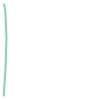

In [55]:
test

In [58]:
region.geometry.convex_hull

0        POLYGON ((-125.17144 41.94418, -125.17129 41.9...
1        POLYGON ((-125.22436 41.90854, -125.22781 41.9...
2        LINESTRING (-124.87544 41.99766, -124.87299 41...
3        POLYGON ((-125.08309 41.85521, -125.08587 41.9...
4        POLYGON ((-125.12949 41.84158, -125.13638 41.9...
                               ...                        
28738    POLYGON ((-115.54155 32.66134, -115.60879 32.7...
28739    POLYGON ((-115.17679 32.71016, -115.20497 32.7...
28740    POLYGON ((-115.35643 32.67477, -115.46926 32.7...
28741    POLYGON ((-114.80180 32.73571, -114.80699 32.7...
28742    POLYGON ((-114.76884 32.71533, -114.80180 32.7...
Length: 28743, dtype: geometry

In [ ]:
# color
# https://plotly.com/python/builtin-colorscales/



In [63]:
poly_json = json.loads(region['geometry'].convex_hull.to_json())

In [64]:
poly_json

{'type': 'FeatureCollection',
 'features': [{'id': '0',
   'type': 'Feature',
   'properties': {},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-125.17143512027636, 41.944181651277695],
      [-125.1712852710697, 41.99626962831054],
      [-125.17051315068892, 41.99203528761517],
      [-125.16988106199403, 41.97695287720971],
      [-125.17036038523254, 41.96089929307316],
      [-125.17143512027636, 41.944181651277695]]]},
   'bbox': [-125.17143512027636,
    41.944181651277695,
    -125.16988106199403,
    41.99626962831054]},
  {'id': '1',
   'type': 'Feature',
   'properties': {},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-125.2243554974312, 41.908536996582185],
      [-125.22781305779222, 41.9136728425837],
      [-125.26062001919958, 41.96853445313801],
      [-125.26829482303818, 41.981392701059896],
      [-125.27224452754719, 41.99040002225149],
      [-125.27394130817, 41.995620544417676],
      [-125.2243554974312, 41.908536996582185]]]},
   'bbox

In [ ]:
fig = go.Figure(data=[go.Choroplethmapbox(
                                    geojson=poly_json,
                                    colorscale='matter_r',
                                    locations=df['id'].astype(str),
                                    z = df['color'].astype(float))])

fig.update_layout(width=1000, height=1000,
                  mapbox = dict(center= sf,  #lat=37, lon=-95          
#                                  accesstoken= mapboxt,
                                 zoom=2.5,
                                 style='light'
                               ))
fig.show()